<a href="https://colab.research.google.com/github/LizVallejos1/Examen3_354/blob/main/ex3_morfologia.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import files #interactuar con los archivos.
uploaded = files.upload() # abre interfaz de carga

In [2]:
import os
import matplotlib.pyplot as plt # para visualizacion en python
from matplotlib.pyplot import imread # para leer imagenes desde archivos
import matplotlib.image as mpimg #funciones para trabajar con imagenes

In [3]:
folder_path = '/content/drive/MyDrive/imagenes_captcha'  # cargo mi carpeta de imagenes
print(folder_path)

/content/drive/MyDrive/imagenes_captcha


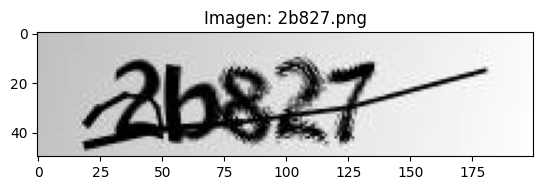

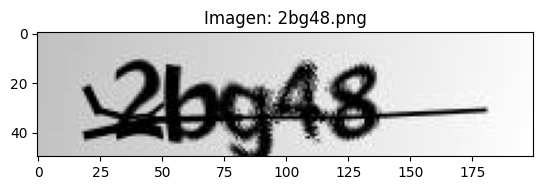

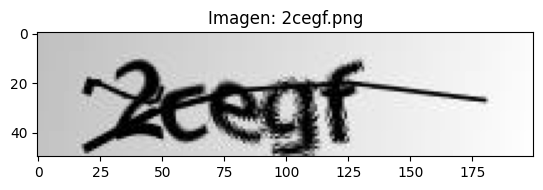

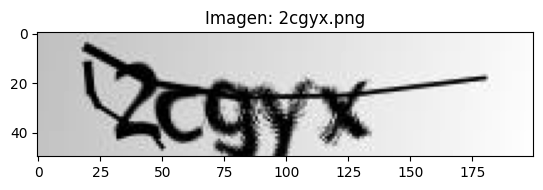

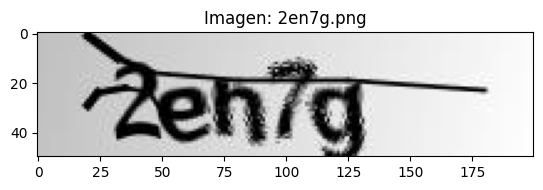

...

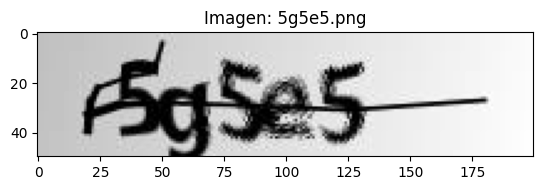

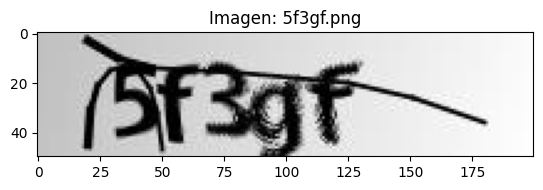

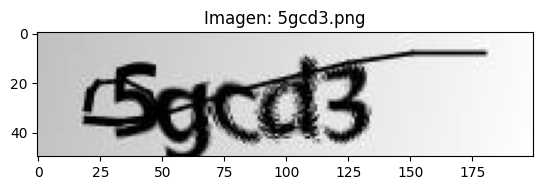

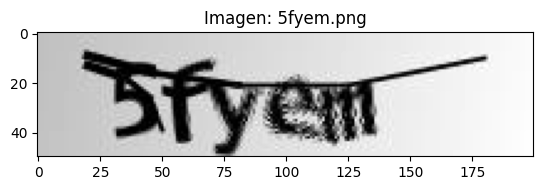

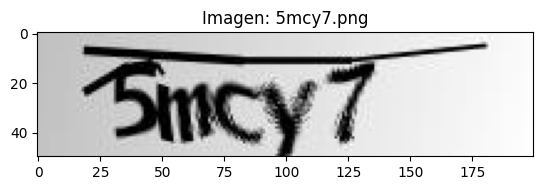

In [4]:
import cv2 #biblioteca de vision por computadora
import numpy as np # estrutura de datos
import matplotlib.pyplot as plt #
import os # para interactuar con el sistema

def mostrar_imagenes_en_directorio(folder_path):
    # Obtener la lista de archivos en el directorio
    archivos_imagenes = os.listdir(folder_path)#para obtener lista de archivos en el directorio especificado

    # Iterar sobre cada archivo de imagen
    for archivo_imagen in archivos_imagenes:
        # Comprobar si el archivo es una imagen
        if archivo_imagen.endswith(('.png', '.jpg', '.jpeg')):
            # Construir la ruta completa de la imagen
            ruta_imagen = os.path.join(folder_path, archivo_imagen)

            # Leer la imagen en escala de grises
            img = cv2.imread(ruta_imagen, 0)

            # Mostrar la imagen
            plt.imshow(img, cmap='gray')
            plt.title(f'Imagen: {archivo_imagen}')
            plt.show()

# Directorio que contiene tus imágenes
folder_path = '/content/drive/MyDrive/imagenes_captcha'

# Llamar a la función para mostrar todas las imágenes en el directorio
mostrar_imagenes_en_directorio(folder_path)


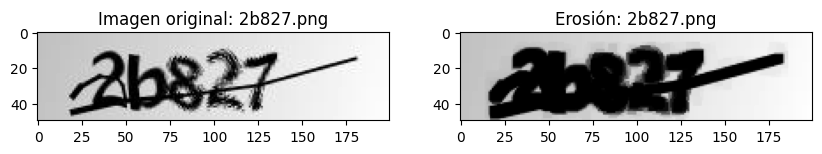

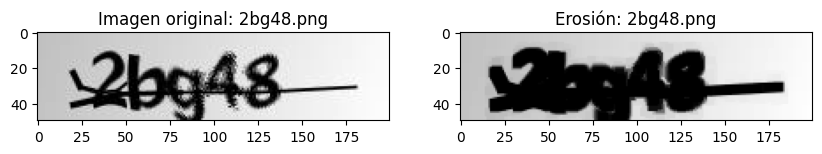

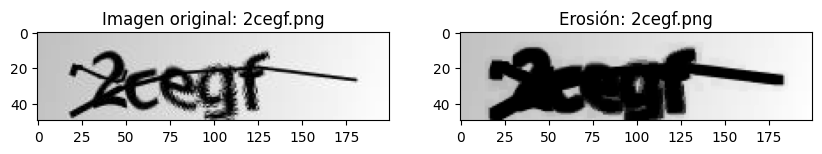

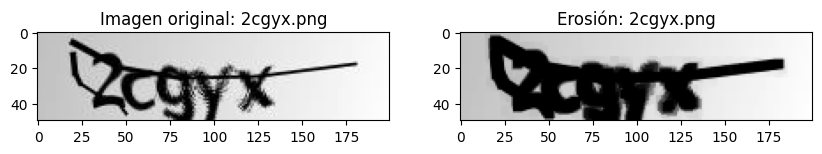

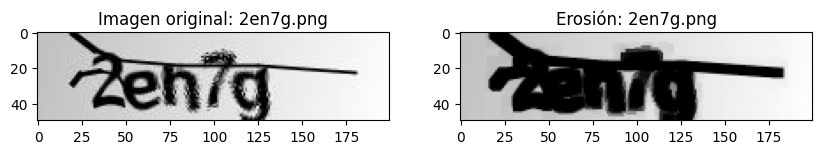

...

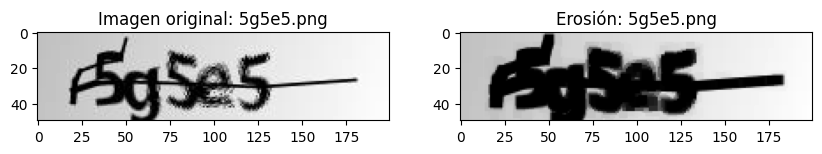

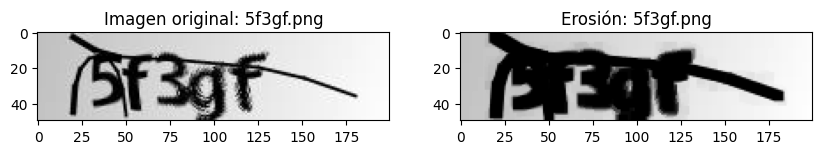

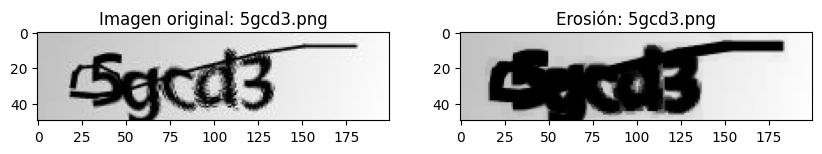

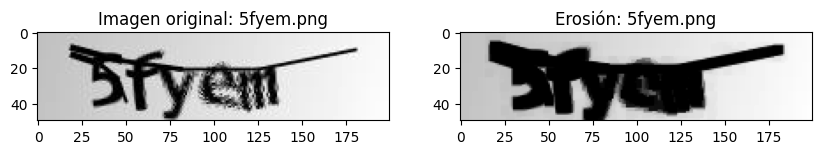

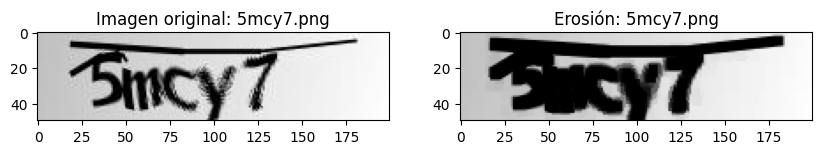

In [5]:
#EROSION
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

def aplicar_erosion_en_directorio(folder_path):
    # Obtener la lista de archivos en el directorio
    archivos_imagenes = os.listdir(folder_path)

    # Iterar sobre cada archivo de imagen
    for archivo_imagen in archivos_imagenes:
        # Comprobar si el archivo es una imagen
        if archivo_imagen.endswith(('.png', '.jpg', '.jpeg')):
            # Construir la ruta completa de la imagen
            ruta_imagen = os.path.join(folder_path, archivo_imagen)

            # Leer la imagen en escala de grises
            img = cv2.imread(ruta_imagen, 0)

            # Aplicar la operación de erosión
            kernel = np.ones((5, 5), np.uint8) #creo kernel de matriz de 1s de tam5x5
            erosion = cv2.erode(img, kernel, iterations=1)#realiza erosion con 1 iteracion

            # Mostrar la imagen original y la imagen después de la erosión
            plt.figure(figsize=(10, 5))#creo new figura tam 10pulgx 5 ancho
            plt.subplot(1, 2, 1)# divido en 1 cuadricula,2columnas,y1raposicion
            plt.imshow(img, cmap='gray')#muestro en escala de grises
            plt.title(f'Imagen original: {archivo_imagen}')

            plt.subplot(1, 2, 2)
            plt.imshow(erosion, cmap='gray')
            plt.title(f'Erosión: {archivo_imagen}')

            plt.show()

# Directorio que contiene tus imágenes
folder_path = '/content/drive/MyDrive/imagenes_captcha'

# Llamar a la función para aplicar erosión a todas las imágenes en el directorio
aplicar_erosion_en_directorio(folder_path)

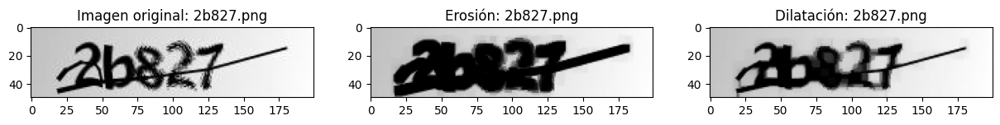

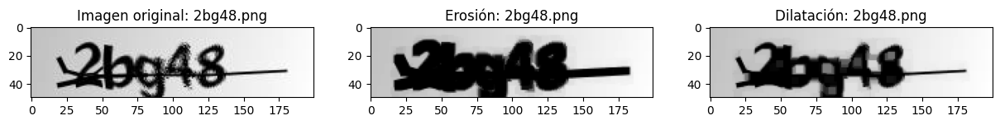

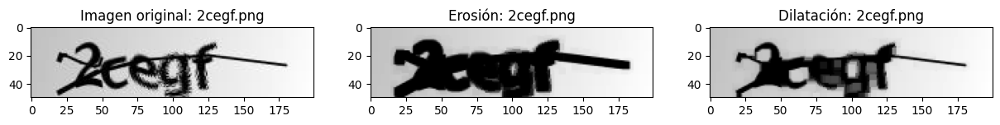

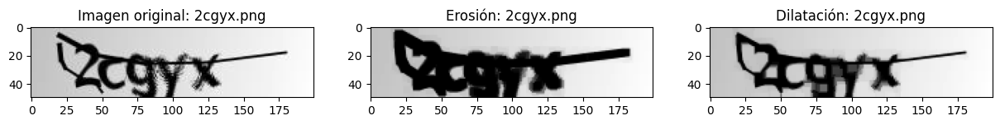

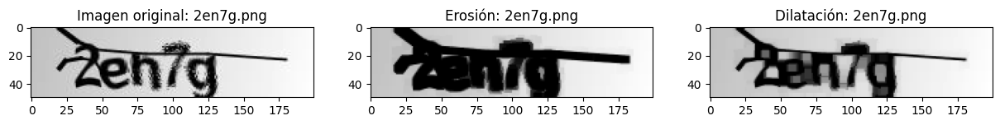

...

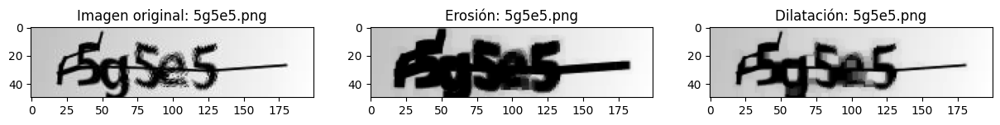

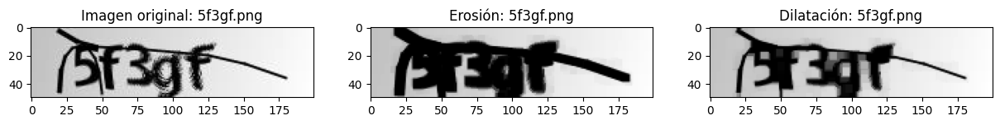

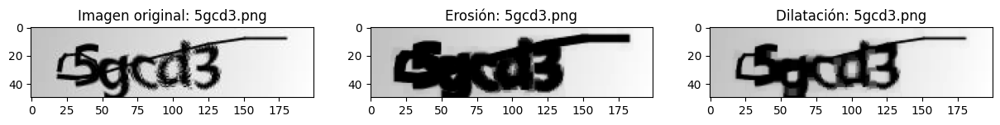

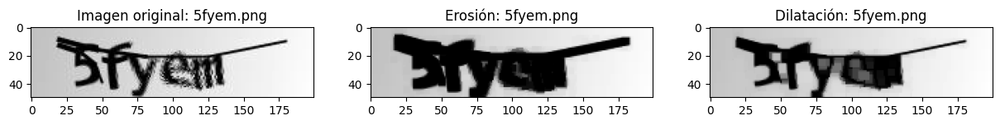

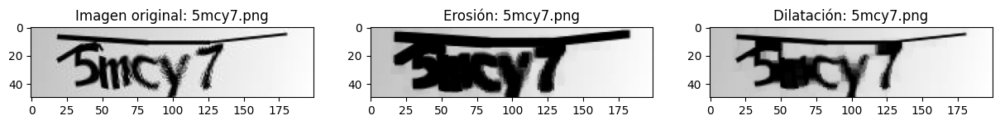

In [6]:
#DILATACION
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

def aplicar_operaciones_morfologicas_en_directorio(folder_path):
    # Obtener la lista de archivos en el directorio
    archivos_imagenes = os.listdir(folder_path)

    # Iterar sobre cada archivo de imagen
    for archivo_imagen in archivos_imagenes:
        # Comprobar si el archivo es una imagen
        if archivo_imagen.endswith(('.png', '.jpg', '.jpeg')):
            # Construir la ruta completa de la imagen
            ruta_imagen = os.path.join(folder_path, archivo_imagen)

            # Leer la imagen en escala de grises
            img = cv2.imread(ruta_imagen, 0)

            # Aplicar la operación de erosión
            kernel = np.ones((5, 5), np.uint8)
            erosion = cv2.erode(img, kernel, iterations=1)

            # Aplicar la operación de dilatación
            dilatacion = cv2.dilate(erosion, kernel, iterations=1)

            # Mostrar la imagen original, la imagen después de la erosión y la imagen después de la dilatación
            plt.figure(figsize=(15, 5))
            plt.subplot(1, 3, 1)
            plt.imshow(img, cmap='gray')
            plt.title(f'Imagen original: {archivo_imagen}')

            plt.subplot(1, 3, 2)
            plt.imshow(erosion, cmap='gray')
            plt.title(f'Erosión: {archivo_imagen}')

            plt.subplot(1, 3, 3)#se divide en 3 y selecciona 3rafila
            plt.imshow(dilatacion, cmap='gray')
            plt.title(f'Dilatación: {archivo_imagen}')

            plt.show()

# Directorio que contiene tus imágenes
folder_path = '/content/drive/MyDrive/imagenes_captcha'

# Llamar a la función para aplicar operaciones morfológicas a todas las imágenes en el directorio
aplicar_operaciones_morfologicas_en_directorio(folder_path)

In [ ]:
#OPENING: apertura, combina 2 pasos previos.
#objetos grandes se conservan ,detalles minimos y regiones ruidosas se eliminan
#abre los espacios enre los objetos y suaviza bordes

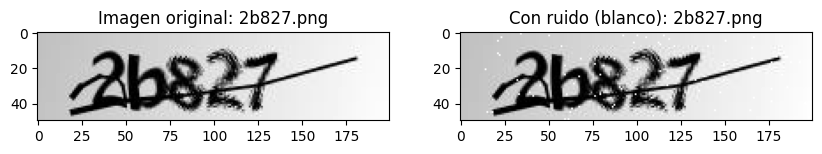

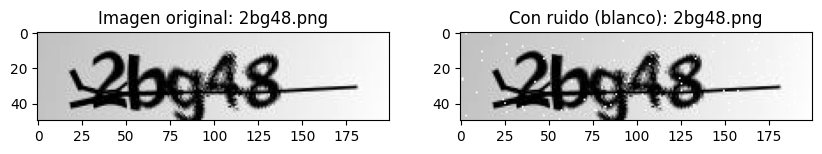

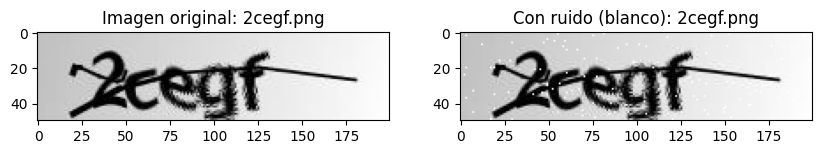

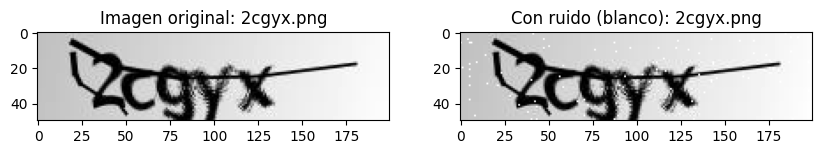

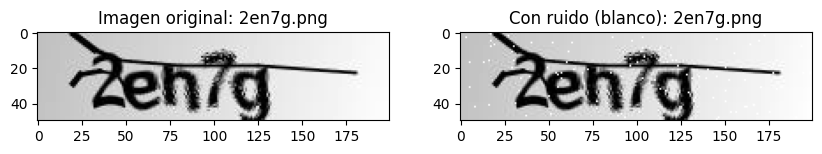

...

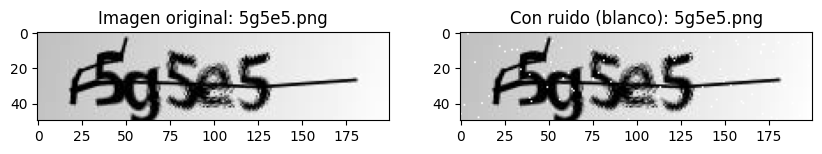

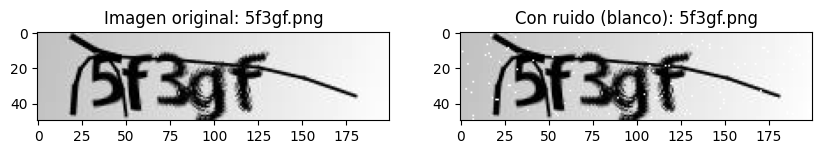

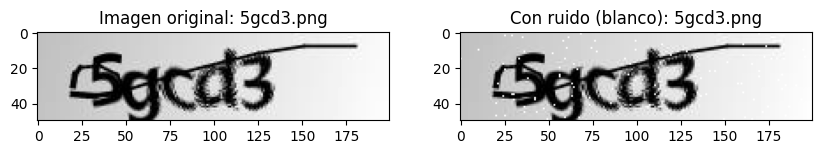

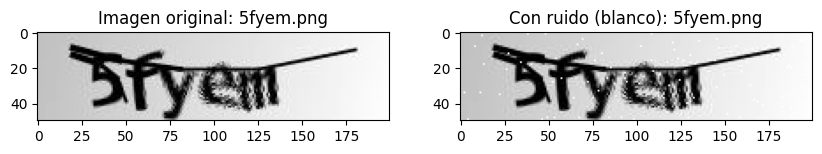

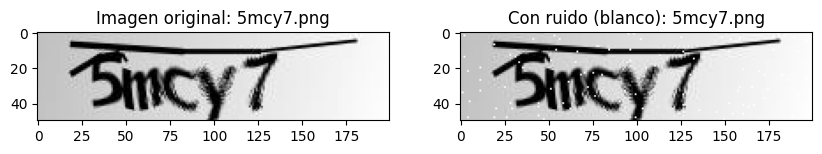

In [7]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

def agregar_ruido_en_directorio(folder_path, probabilidad_ruido=0.01):
    # Obtener la lista de archivos en el directorio
    archivos_imagenes = os.listdir(folder_path)

    # Iterar sobre cada archivo de imagen
    for archivo_imagen in archivos_imagenes:
        # Comprobar si el archivo es una imagen
        if archivo_imagen.endswith(('.png', '.jpg', '.jpeg')):
            # Construir la ruta completa de la imagen
            ruta_imagen = os.path.join(folder_path, archivo_imagen)

            # Leer la imagen en escala de grises
            img = cv2.imread(ruta_imagen, 0)

            # Agregar ruido blanco con una cierta probabilidad
            (N, M) = img.shape
            img_con_ruido = img.copy()#creo copia del original
            #inicio bucle para recorrer cada pixel
            for i in range(N):
                for j in range(M):  #si numero aleatorio >1
                    if np.random.rand() > (1 - probabilidad_ruido):
                        img_con_ruido[i, j] = 255#el pixel en la posicion ij, se represetna con blanco
                        #si hay ruido
            # Mostrar la imagen original y la imagen con ruido
            plt.figure(figsize=(10, 5))
            plt.subplot(1, 2, 1)
            plt.imshow(img, cmap='gray')
            plt.title(f'Imagen original: {archivo_imagen}')

            plt.subplot(1, 2, 2)
            plt.imshow(img_con_ruido, cmap='gray')
            plt.title(f'Con ruido (blanco): {archivo_imagen}')

            plt.show()

# Directorio que contiene tus imágenes
folder_path = '/content/drive/MyDrive/imagenes_captcha'

# Llamar a la función para agregar ruido a todas las imágenes en el directorio
agregar_ruido_en_directorio(folder_path)

In [8]:
#CLOSING:cierre  #para cerrar pequeños agujeros en los objetos y suavizar

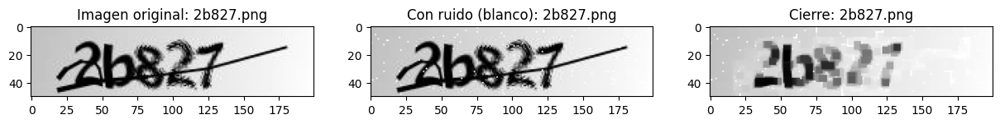

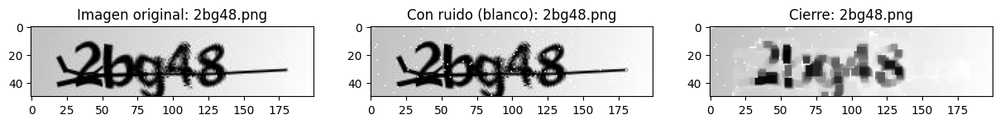

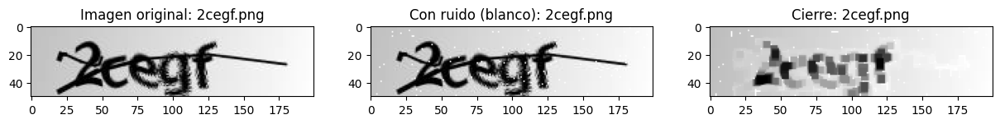

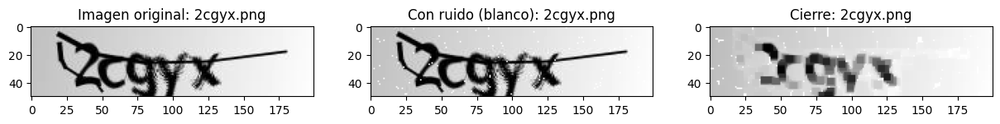

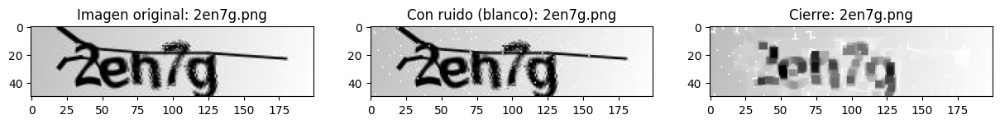

...

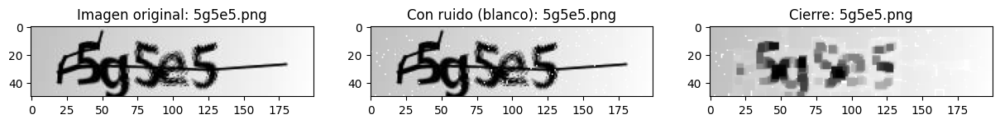

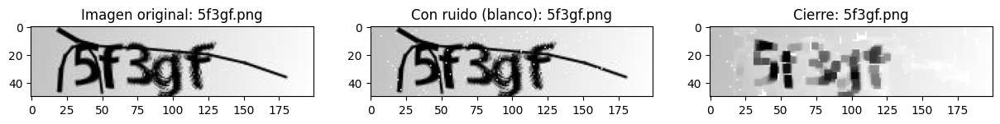

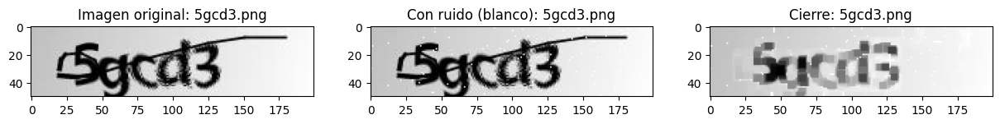

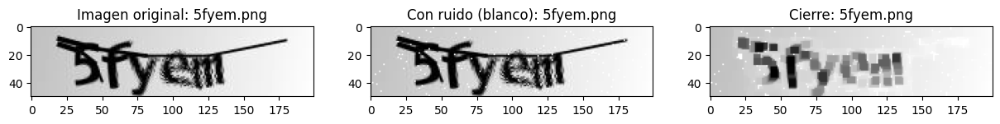

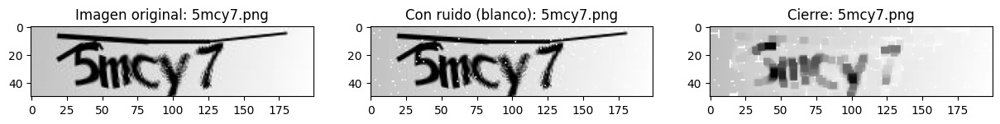

In [9]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

def aplicar_cierre_en_directorio(folder_path, probabilidad_ruido=0.01):
    # Obtener la lista de archivos en el directorio
    archivos_imagenes = os.listdir(folder_path)

    # Definir el kernel para la operación de cierre
    kernel = np.ones((5, 5), np.uint8)

    # Iterar sobre cada archivo de imagen
    for archivo_imagen in archivos_imagenes:
        # Comprobar si el archivo es una imagen
        if archivo_imagen.endswith(('.png', '.jpg', '.jpeg')):
            # Construir la ruta completa de la imagen
            ruta_imagen = os.path.join(folder_path, archivo_imagen)

            # Leer la imagen en escala de grises
            img = cv2.imread(ruta_imagen, 0)

            # Agregar ruido blanco con una cierta probabilidad
            (N, M) = img.shape
            img_con_ruido = img.copy()#creo copia de original

            for i in range(N):
                for j in range(M):
                    if np.random.rand() > (1 - probabilidad_ruido):
                        img_con_ruido[i, j] = 255

            # Aplicar la operación de cierre, primero dilatacion,erosion
            closing = cv2.morphologyEx(img_con_ruido, cv2.MORPH_CLOSE, kernel)
                #para cerrar pequeños agujeros en los objetos y suavizar
            # Mostrar la imagen original, la imagen con ruido y la imagen después de cierre
            plt.figure(figsize=(15, 5))
            plt.subplot(1, 3, 1)
            plt.imshow(img, cmap='gray')
            plt.title(f'Imagen original: {archivo_imagen}')

            plt.subplot(1, 3, 2)
            plt.imshow(img_con_ruido, cmap='gray')
            plt.title(f'Con ruido (blanco): {archivo_imagen}')

            plt.subplot(1, 3, 3)
            plt.imshow(closing, cmap='gray')
            plt.title(f'Cierre: {archivo_imagen}')

            plt.show()

# Directorio que contiene tus imágenes
folder_path = '/content/drive/MyDrive/imagenes_captcha'

# Llamar a la función para aplicar cierre a todas las imágenes en el directorio
aplicar_cierre_en_directorio(folder_path)

In [10]:
#GRADIENTE
def apply_morphological_gradient(input_image, kernel):
    gradient = cv2.morphologyEx(input_image, cv2.MORPH_GRADIENT, kernel)#se aplicagradientea la imgane ,operacion gradeinte,elemento estructurante utlizado
    return gradient

In [11]:
#gradiente: resalta bordes

In [12]:
def morphological_gradient_for_folder(folder_path):
    # Obtener la lista de archivos en el directorio
    archivos_imagenes = os.listdir(folder_path)

    # Crear un kernel para la operación morfológica
    kernel = np.ones((5, 5), np.uint8)

    # Iterar sobre cada archivo en el directorio
    for nombre_archivo in archivos_imagenes:
        # Comprobar si el archivo es una imagen (puedes ajustar según tus necesidades)
        if nombre_archivo.endswith(('.png', '.jpg', '.jpeg')):
            # Construir la ruta completa de la imagen
            ruta_imagen = os.path.join(folder_path, nombre_archivo)

            # Cargar la imagen con OpenCV
            img = cv2.imread(ruta_imagen, cv2.IMREAD_GRAYSCALE)

            # Aplicar la operación de gradiente morfológico
            gradient = apply_morphological_gradient(img, kernel)

            # Visualizar la imagen original y la imagen después del gradiente morfológico
            plt.figure(figsize=(15, 18))

            plt.subplot(1, 2, 1)
            plt.imshow(img, cmap='gray')
            plt.title(f'Imagen original: {nombre_archivo}')

            plt.subplot(1, 2, 2)
            plt.imshow(gradient, cmap='gray')
            plt.title(f'Gradiente morfológico: {nombre_archivo}')

            plt.show()

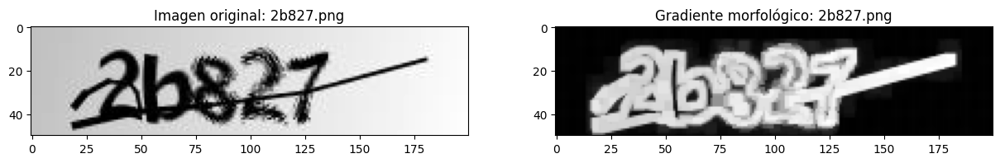

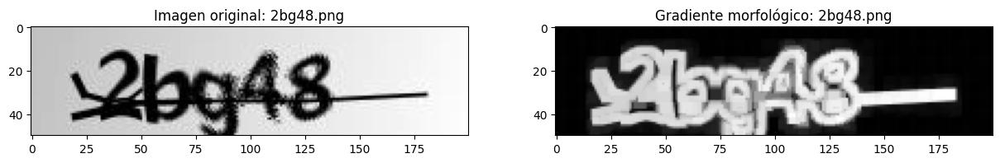

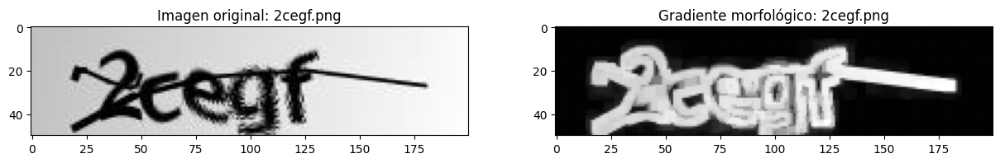

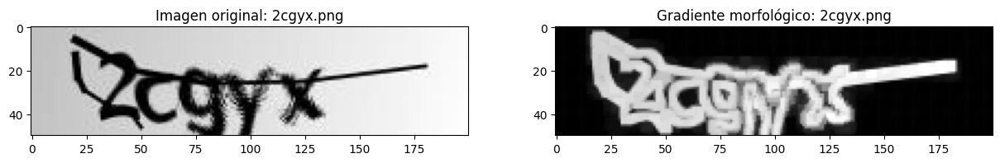

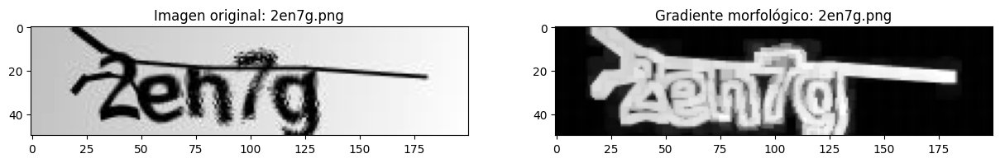

...

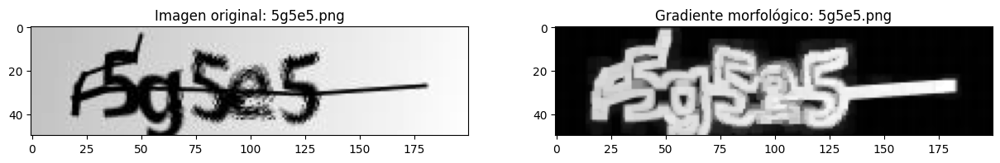

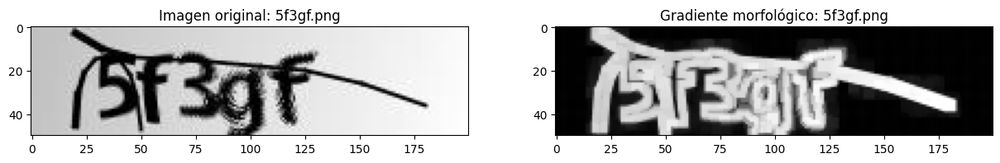

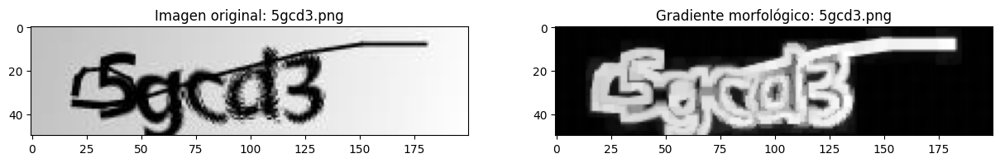

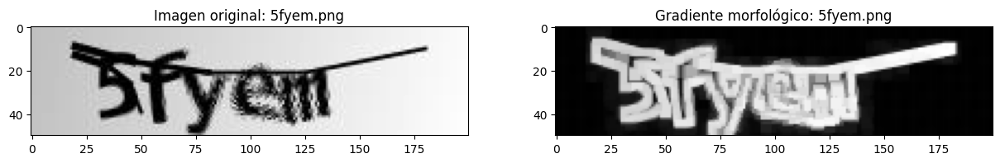

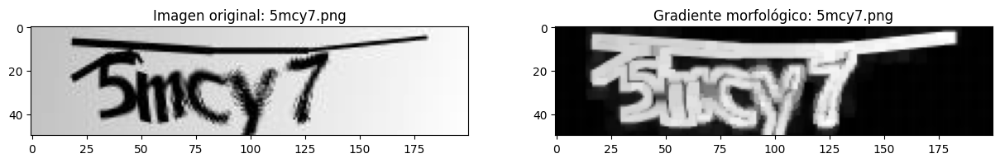

In [ ]:
# Llamar a la función con la ruta de tu directorio de imágenes
morphological_gradient_for_folder('/content/drive/MyDrive/imagenes_captcha')